# Crime data 

In [17]:
import pandas as pd # type: ignore
import numpy as np # type: ignore
import matplotlib.pyplot as plt # type: ignore
import seaborn as sns # type: ignore
import plotly.express as px # type: ignore

crime_data = pd.read_csv('/Users/angeneris/la_crime_data/la_crime_data/Crime_Data_from_2020_to_Present.csv')
crime_data

crime = crime_data[['Date Rptd','DATE OCC', 'Crm Cd Desc', 'Status Desc','AREA NAME']]
#fixing column names

crime = crime.rename(columns={'Date Rptd':'date_reported'
                      ,'DATE OCC':'crime_date',
                        'Crm Cd Desc':'crime',
                          'Status Desc': 'status',
                          'AREA NAME': 'crime_area'

})

crime

,date_reported,crime_date,crime,status,crime_area
0,03/01/2020 12:00:00 AM,03/01/2020 12:00:00 AM,VEHICLE - STOLEN,Adult Arrest,Wilshire
1,02/09/2020 12:00:00 AM,02/08/2020 12:00:00 AM,BURGLARY FROM VEHICLE,Invest Cont,Central
2,11/11/2020 12:00:00 AM,11/04/2020 12:00:00 AM,BIKE - STOLEN,Invest Cont,Southwest
3,05/10/2023 12:00:00 AM,03/10/2020 12:00:00 AM,SHOPLIFTING-GRAND THEFT ($950.01 & OVER),Invest Cont,Van Nuys
4,08/18/2022 12:00:00 AM,08/17/2020 12:00:00 AM,THEFT OF IDENTITY,Invest Cont,Hollywood
...,...,...,...,...,...
932135,02/11/2024 12:00:00 AM,02/11/2024 12:00:00 AM,TRESPASSING,Adult Arrest,Foothill
932136,01/14/2024 12:00:00 AM,01/13/2024 12:00:00 AM,"ASSAULT WITH DEADLY WEAPON, AGGRAVATED ASSAULT",Invest Cont,Foothill
932137,02/20/2024 12:00:00 AM,02/17/2024 12:00:00 AM,THEFT FROM MOTOR VEHICLE - PETTY ($950 & UNDER),Invest Cont,Topanga
932138,01/16/2024 12:00:00 AM,01/16/2024 12:00:00 AM,BATTERY - SIMPLE ASSAULT,Invest Cont,Olympic


In [18]:
#Having a peak at the data 

crime.sample(10)

,date_reported,crime_date,crime,status,crime_area
520490,02/06/2022 12:00:00 AM,02/05/2022 12:00:00 AM,BURGLARY FROM VEHICLE,Invest Cont,Central
870609,02/11/2023 12:00:00 AM,02/05/2023 12:00:00 AM,THEFT PLAIN - PETTY ($950 & UNDER),Invest Cont,Pacific
807716,07/19/2023 12:00:00 AM,07/18/2023 12:00:00 AM,VEHICLE - STOLEN,Invest Cont,Central
165559,08/04/2020 12:00:00 AM,08/04/2020 12:00:00 AM,SHOPLIFTING - PETTY THEFT ($950 & UNDER),Invest Cont,Central
284824,10/20/2021 12:00:00 AM,10/20/2021 12:00:00 AM,BATTERY - SIMPLE ASSAULT,Adult Arrest,Mission
884304,03/26/2024 12:00:00 AM,03/25/2024 12:00:00 AM,INTIMATE PARTNER - SIMPLE ASSAULT,Invest Cont,Devonshire
651589,02/12/2023 12:00:00 AM,02/12/2023 12:00:00 AM,VANDALISM - MISDEAMEANOR ($399 OR UNDER),Invest Cont,Olympic
581405,12/07/2022 12:00:00 AM,12/07/2022 12:00:00 AM,THEFT OF IDENTITY,Invest Cont,Topanga
389096,08/16/2021 12:00:00 AM,08/15/2021 12:00:00 AM,THEFT FROM MOTOR VEHICLE - PETTY ($950 & UNDER),Invest Cont,Pacific
701083,11/07/2023 12:00:00 AM,11/07/2023 12:00:00 AM,INTIMATE PARTNER - SIMPLE ASSAULT,Adult Arrest,Pacific


Using neighborhood_crime we can view some simple descriptive information. 

In [19]:
crime.describe()

,date_reported,crime_date,crime,status,crime_area
count,932140,932140,932140,932140,932140
unique,1567,1567,139,6,21
top,02/03/2023 12:00:00 AM,01/01/2020 12:00:00 AM,VEHICLE - STOLEN,Invest Cont,Central
freq,925,1138,100225,745184,63133


According to the data, the most frequent date for crimes reported was on 2/3/2023.
The date in which most crimes occured was 1/1/2020 at 12:00am. 
There are 139 unique reported crime types 
The top reported crime is for Vehichle Stolen with a frequency of occurence of 100,225 times. <br> <br>
We can see the location with the most crime reported and it's frequency. 
There are 21 locations with reported crime.  <br> <br>
The area location where crime is reported the most is Central with a frequency of 63,133 times.  <br> <br>
There are 6 unique markers for status of investigation. 
The top status of crime is Invest Cont occuring 745,184 times 

In [20]:
crime.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 932140 entries, 0 to 932139
Data columns (total 5 columns):
 #   Column         Non-Null Count   Dtype 
---  ------         --------------   ----- 
 0   date_reported  932140 non-null  object
 1   crime_date     932140 non-null  object
 2   crime          932140 non-null  object
 3   status         932140 non-null  object
 4   crime_area     932140 non-null  object
dtypes: object(5)
memory usage: 35.6+ MB


We will change all time based columns to date time type instead of object. 

In [21]:
# Split the datetime strings by space and keep only the date part
crime['date_reported'] = crime['date_reported'].str.split().str[0]
crime['crime_date'] = crime['crime_date'].str.split().str[0]

# Convert the date parts to datetime format
crime['date_reported'] = pd.to_datetime(crime['date_reported'], format='%m/%d/%Y')
crime['crime_date'] = pd.to_datetime(crime['crime_date'], format='%m/%d/%Y')

# Sort the data by 'date_reported' for ease of analysis
crime = crime.sort_values(by='date_reported')


crime 


,date_reported,crime_date,crime,status,crime_area
163321,2020-01-01,2020-01-01,INTIMATE PARTNER - AGGRAVATED ASSAULT,Adult Arrest,Foothill
79481,2020-01-01,2020-01-01,CRIMINAL THREATS - NO WEAPON DISPLAYED,Invest Cont,Topanga
44778,2020-01-01,2020-01-01,DISTURBING THE PEACE,Invest Cont,Olympic
46387,2020-01-01,2020-01-01,VANDALISM - MISDEAMEANOR ($399 OR UNDER),Invest Cont,Hollywood
183724,2020-01-01,2020-01-01,BRANDISH WEAPON,Adult Arrest,Devonshire
...,...,...,...,...,...
894648,2024-04-15,2024-04-14,VEHICLE - STOLEN,Invest Cont,Van Nuys
886903,2024-04-15,2024-04-14,"VANDALISM - FELONY ($400 & OVER, ALL CHURCH VA...",Invest Cont,Central
916032,2024-04-15,2024-04-14,ROBBERY,Invest Cont,Van Nuys
915921,2024-04-15,2024-04-15,THEFT FROM MOTOR VEHICLE - GRAND ($950.01 AND ...,Invest Cont,Southwest


In [22]:
# Calculate the number of days between investigations
crime['days_between_report'] = (crime['date_reported'] - crime['crime_date']).dt.days

# Check the first few rows to verify the new column
print(crime[['date_reported', 'crime_date', 'days_between_report']].head())




       date_reported crime_date  days_between_report
163321    2020-01-01 2020-01-01                    0
79481     2020-01-01 2020-01-01                    0
44778     2020-01-01 2020-01-01                    0
46387     2020-01-01 2020-01-01                    0
183724    2020-01-01 2020-01-01                    0


We removed the exact time off of these columns due to parsing issues and the time is not relevant for the analysis in this project. We will be viewing the data for the amount of days between investigations instead. 

In [23]:
crime_duplicates = crime[crime.duplicated]

crime_duplicates


,date_reported,crime_date,crime,status,crime_area,days_between_report
86898,2020-01-01,2020-01-01,VANDALISM - MISDEAMEANOR ($399 OR UNDER),Invest Cont,Hollywood,0
36307,2020-01-01,2020-01-01,"ASSAULT WITH DEADLY WEAPON, AGGRAVATED ASSAULT",Invest Cont,77th Street,0
46580,2020-01-01,2020-01-01,"ASSAULT WITH DEADLY WEAPON, AGGRAVATED ASSAULT",Invest Cont,Hollywood,0
146898,2020-01-01,2020-01-01,BATTERY - SIMPLE ASSAULT,Adult Other,Devonshire,0
10237,2020-01-01,2020-01-01,BATTERY - SIMPLE ASSAULT,Invest Cont,Mission,0
...,...,...,...,...,...,...
887631,2024-04-15,2024-04-14,OTHER MISCELLANEOUS CRIME,Invest Cont,77th Street,1
891593,2024-04-15,2024-04-14,"ASSAULT WITH DEADLY WEAPON, AGGRAVATED ASSAULT",Invest Cont,77th Street,1
921513,2024-04-15,2024-04-15,INTIMATE PARTNER - SIMPLE ASSAULT,Invest Cont,Van Nuys,0
894648,2024-04-15,2024-04-14,VEHICLE - STOLEN,Invest Cont,Van Nuys,1


Doesn't appear that any true duplicates are present. Many of the rows have very subtle differences but no exact full duplicates are obvious after searching. 

All of the current data looks good, we can proceed with SDA  

In [24]:
# Save the DataFrame to a new CSV file for future use
crime.to_csv('/Users/angeneris/Sprint_4_Project/Sprint_4_Project/notebooks/crime_data_2020_to_present.csv', index=False)

### Questions to consider: 
How long do people wait to report crimes? 

How does the type of crime committed influence the time in which it takes to report the crime?

Do certain types of crime continue to stay under investigation for longer?  

What relationship does date and time have on types of crimes committed? 

Which areas in this dataset have the highest levels of crimes being committted and what types of crime? 



## SDA

There is a lot of data in this data set and a over 100 types of crime reported. It's likely that many of these types of crimes are a variation of a more general crime type. We can simplify analysis by removing crime types with very little data. <br>

<br>
By plotting the data we can see these differences more clearly. We will view the top 20 crimes and break down from there.

NOTE: The charts at the beginning of this analysis represent data for 'all-time' rather than crimes per year. There may be distortion of data when viewing the data from this perspective. All-time data is from year 2020 - 2024.

### Top 20 Crimes 

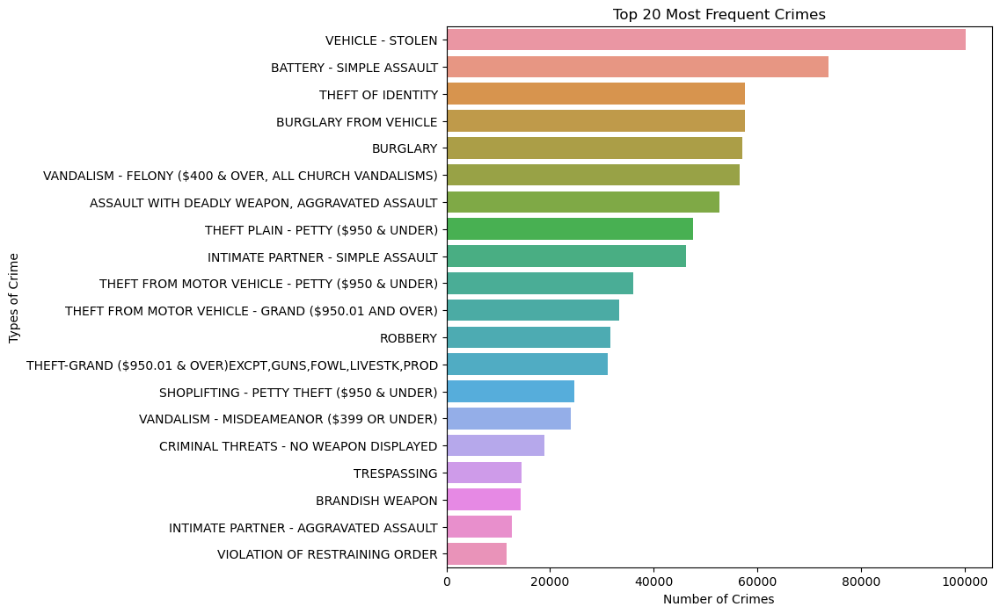

In [25]:
crime_counts = crime['crime'].value_counts()

#Plot top 25 most frequent crimes 
plt.figure(figsize=(8,8))
sns.barplot(y=crime_counts.head(20).index, x=crime_counts.head(20).values)
plt.xlabel('Number of Crimes')
plt.ylabel('Types of Crime')
plt.title('Top 20 Most Frequent Crimes')
plt.show()

### Top 10 Crimes 
The top 10 crimes shows a clear picture of theft and assault being a big problem in LA. The chart especially shows how much theft and burglary in particular dominate the crimal activity in the city: 
<br><br>
6 out of 10 of these crime types are related to theft or burglary. 
<br>
3 out of 10 of these crime types are related to assault. 
<br>
1 out of 10 are related to vandilsim. 
<br>

The top 10 crimes appears to be too small of sample for deeper analysis so we will continue to work with Top 20 crimes to view a larger variation. 

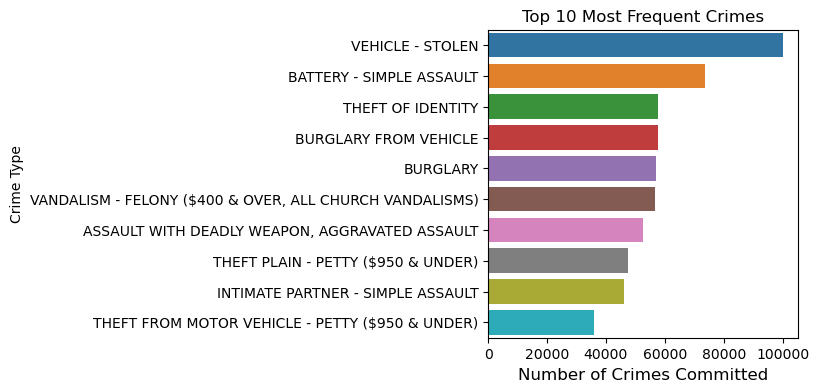

In [26]:
# Count the occurrence of each crime type 
crime_counts = crime['crime'].value_counts()

# Plot the top 10 most frequent crimes
plt.figure(figsize=(4,4))
sns.barplot(y=crime_counts.head(10).index, x=crime_counts.head(10).values)
plt.ylabel('Crime Type')
plt.xlabel('Number of Crimes Committed', fontsize=12)
plt.title('Top 10 Most Frequent Crimes')
plt.show()


In [27]:
# Count the occurrence of each crime type 
crime_counts = crime['crime'].value_counts()
crime_counts.head(10).index


Index(['VEHICLE - STOLEN', 'BATTERY - SIMPLE ASSAULT', 'THEFT OF IDENTITY',
       'BURGLARY FROM VEHICLE', 'BURGLARY',
       'VANDALISM - FELONY ($400 & OVER, ALL CHURCH VANDALISMS)',
       'ASSAULT WITH DEADLY WEAPON, AGGRAVATED ASSAULT',
       'THEFT PLAIN - PETTY ($950 & UNDER)',
       'INTIMATE PARTNER - SIMPLE ASSAULT',
       'THEFT FROM MOTOR VEHICLE - PETTY ($950 & UNDER)'],
      dtype='object', name='crime')

### Crimes by Neighborhood

We will continue to look at the 'Top 20' with this data set to determine the relationship between crimes comitted and location. 

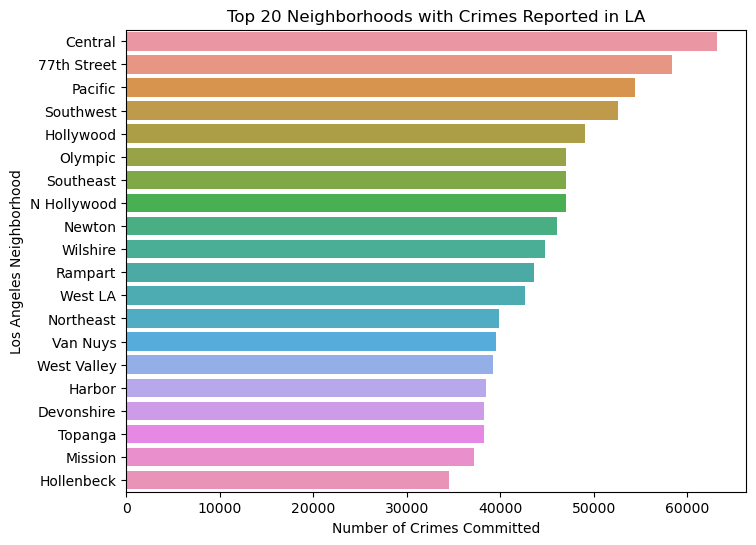

In [28]:
# Count the occurrence of each crime type 
crime_counts = crime['crime_area'].value_counts()

# Plot the top 20 most frequent areas of crime
plt.figure(figsize=(8,6))
sns.barplot(x=crime_counts.head(20).values, y=crime_counts.head(20).index)
plt.xlabel('Number of Crimes Committed')
plt.ylabel('Los Angeles Neighborhood')
plt.title('Top 20 Neighborhoods with Crimes Reported in LA')
plt.show()

From the bar chart above, it appears that there are three distinct categories for crimes in these neighborhoods. 

**Extreme:** Neighborhoods reporting more than 50,000 crimes (2020-2024) <br>
**High:** Neighborhoods reporting between 40,000 crimes - 50,000 crimes (2020-2024)<br>
**Moderate:** Neighborhoods reporting less than 40,000 crimes (2020-2024)

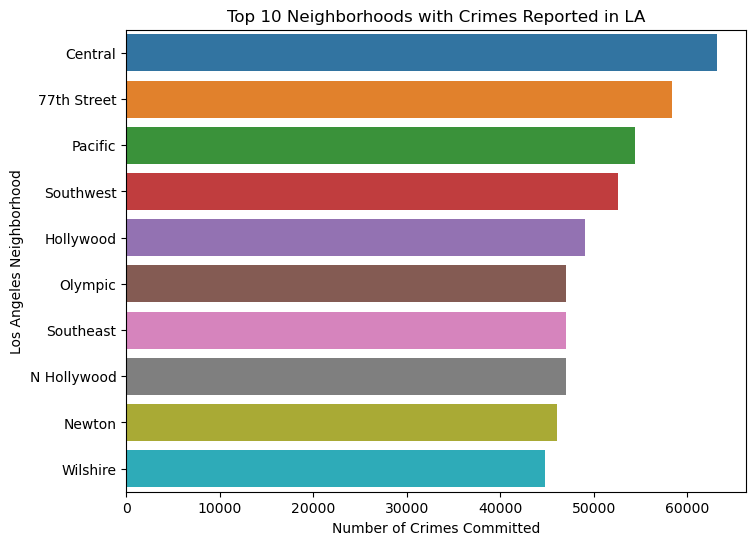

In [29]:
# Count the occurrence of each crime type 
crime_counts = crime['crime_area'].value_counts()

# Plot the Crimes in the Top 10 Neighborhoods with Crimes Reported in LA'
plt.figure(figsize=(8,6))
sns.barplot(x=crime_counts.head(10).values, y=crime_counts.head(10).index)
plt.xlabel('Number of Crimes Committed')
plt.ylabel('Los Angeles Neighborhood')
plt.title('Top 10 Neighborhoods with Crimes Reported in LA')
plt.show()

From this bar chart above, it appears that the neighborhoods plotted share a relatively similar crime rate. This also aligns with the previous statement categorizing the neighborhoods into 3 groups of crime severity. The top 10 shows only the neighborhoods with the criteria of "High" and "Extreme".

### Crime Dates and Reporting of Crimes 

In [30]:
# Create a histogram with custom bin edges
fig = px.histogram(crime, x='days_between_report', title='Histogram of Days Between Crimes and Reporting of Crimes',
                   labels={'days_between_report': 'Days Between Crimes and Reporting of Crimes'}, histfunc='count', nbins=20)

# Show the plot
fig.show()

max_days = crime['days_between_report'].max()
print(f'The longest time between a crime and it\'s report is: {max_days} days old.')

The longest time between a crime and it's report is: 1547 days old.


The outlier printed above is pretty extreme which makes this histogram a bit difficult to read. We can remove any outliers and plot the data again to see if there are improvements. After reviewing the data, almost all crimes are reported within 100 days, with most being reported within less than a week. We will only view data for crimes reported within a week for this section. 

In [31]:
#Removes outliers over
reported_crime = crime[crime['days_between_report'] < 8]

#Check to confirm that max value does not exceed 7 days
reported_crime['days_between_report'].max()

7

In [32]:
# Creates a histogram with new bins
fig = px.histogram(reported_crime, x='days_between_report', title='Histogram of Days Between Crimes and Reporting of Crimes',
                   labels={'days_between_report': 'Days Between Crimes and Reporting of Crimes'}, histfunc= 'count', nbins=5)

# Show the plot
fig.show()


The histogram above shows that the vast majority of crimes in LA are reported promptly. The majority of crimes are reported on the day of occurence or within a day of their occurence. 

## Grouping Data 

### For further analysis: After submitting this project I will continue working on this
<br> 
Here we will group data based on key factors in order to complete a more complete analysis. 

Group data by more general crime types: 
Assault 
Theft 
Vandilism 
Other Misc Crimes



